In [ ]:
# RUN THIS IN THE VERY FIRST CELL
%env HF_HUB_OFFLINE=1

import os
os.environ["HF_HUB_OFFLINE"] = "1"

print("Offline mode forced.")

import torch
import numpy as np

env: HF_HUB_OFFLINE=1
Offline mode forced.


In [2]:
from models import Qwen3VL
from models.utils import load_all_frames_from_folder, build_chunks_from_full_video

qwen_model = Qwen3VL()

/leonardo/home/userexternal/lzhou001/miniconda3/envs/EfficientGEBD/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/leonardo/home/userexternal/lzhou001/miniconda3/envs/EfficientGEBD/lib/python3.10/site-packages/transformers/utils/hub.py:110: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(
/leonardo/home/userexternal/lzhou001/miniconda3/envs/EfficientGEBD/lib/python3.10/site-packages/transformers/models/auto/modeling_auto.py:2284: FutureWarning: The class `AutoModelForVision2Seq` is deprecated and will be removed in v5.0. Please use `AutoModelForImageTextToText` instead.
  warnings.warn(
`torch_dtype` is deprecated! Use `dtype` instead!
Loading checkpoint shards: 100%|███████████████████████████████████████████████

In [3]:
from datasets.annot_utils import load_gt_annotations, get_video_gt_info
from datasets.tapos import TAPOSDataset

BASE_DIR = "data/TAPOS/images/val"
SPLIT_FILE = "random_100_val_split.txt"
GT_ANNOTATION_PATH = "data/TAPOS/tapos_gt_val.pkl"

tapos_dataset = TAPOSDataset(
    base_dir=BASE_DIR,
    split_file=SPLIT_FILE,
    gt_annotation_path=GT_ANNOTATION_PATH,
    chunk_size=16)

Loaded annotations for 1755 videos.


In [3]:
from datasets.annot_utils import load_gt_annotations, get_video_gt_info
from datasets.tapos1 import TaposDataset

BASE_DIR = "data/TAPOS/images/val"
SPLIT_FILE = "random_100_val_split.txt"
GT_ANNOTATION_PATH = "data/TAPOS/tapos_gt_val.pkl"

tapos_dataset = TaposDataset(
    base_dir=BASE_DIR,
    split_file=SPLIT_FILE,
    gt_annotation_path=GT_ANNOTATION_PATH,
    chunk_duration=0.5,
    num_frames_per_chunk=8)

Loaded annotations for 1755 videos.


In [4]:
video = tapos_dataset[7]
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]

prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
current_description = qwen_model.infer(first_chunk, prompt, sample_fps=video_fps)
print(f"First chunk: Initial description: {current_description}")

alignment_prompt = "Given the previous event description: {previous_description}, is this the same event or a new one? Respond ONLY with 'SAME' if it's the same or 'NEW' if it's a new event."
alignment_prompt = alignment_prompt.format(previous_description=current_description)

cand_probs_list = []

for idx, chunk in enumerate(video_chunks[1:]):
    frame_chunk = chunk
    inputs = qwen_model._prepare_inputs(frame_chunk, alignment_prompt, sample_fps=video_fps)
    cand_prob = qwen_model.get_next_token_probs(frame_chunk, alignment_prompt, sample_fps=video_fps, candidate_strings=["SAME", "NEW"])
    cand_probs_list.append(cand_prob)

cand_probs_list, video["chunk_labels"]

# Assuming 'cand_probs_list' and 'video' are defined as in your snippet

# 1. Flatten the labels list (since it's inside a nested list [[...]])
chunk_labels = video["chunk_labels"][0]

# 2. Iterate starting from the second entry (index 1) of cand_probs_list
#    and the first entry (index 0) of chunk_labels simultaneously.
#    We use zip to pair them up safely.
for prob_entry, label in zip(cand_probs_list[1:], chunk_labels):
    prob_entry['LABEL'] = label

cand_probs_list

The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.


First chunk: Initial description: A weightlifter is preparing to lift a barbell with red weights. He is standing in a gym with several people watching him. He takes a deep breath and lifts the barbell off the ground, raising it to his chest. He then lowers the barbell back to the ground.


[{'SAME': 0.796875, 'NEW': 0.2021484375},
 {'SAME': 0.73046875, 'NEW': 0.26953125, 'LABEL': 0},
 {'SAME': 0.81640625, 'NEW': 0.1826171875, 'LABEL': 0},
 {'SAME': 0.87890625, 'NEW': 0.119140625, 'LABEL': 0},
 {'SAME': 0.81640625, 'NEW': 0.1826171875, 'LABEL': 0},
 {'SAME': 0.8359375, 'NEW': 0.1640625, 'LABEL': 0},
 {'SAME': 0.796875, 'NEW': 0.2021484375, 'LABEL': 0},
 {'SAME': 0.796875, 'NEW': 0.2021484375, 'LABEL': 1},
 {'SAME': 0.796875, 'NEW': 0.2021484375, 'LABEL': 0},
 {'SAME': 0.796875, 'NEW': 0.2021484375, 'LABEL': 0},
 {'SAME': 0.77734375, 'NEW': 0.22265625, 'LABEL': 0},
 {'SAME': 0.1328125, 'NEW': 0.8671875, 'LABEL': 0},
 {'SAME': 0.53125, 'NEW': 0.46875, 'LABEL': 0},
 {'SAME': 0.3203125, 'NEW': 0.6796875, 'LABEL': 0},
 {'SAME': 0.5, 'NEW': 0.5, 'LABEL': 0},
 {'SAME': 0.4375, 'NEW': 0.5625, 'LABEL': 0},
 {'SAME': 0.1826171875, 'NEW': 0.81640625, 'LABEL': 0},
 {'SAME': 0.81640625, 'NEW': 0.1826171875, 'LABEL': 1}]

In [5]:

import matplotlib.pyplot as plt

def plot_image_grid(image_rows, figsize_per_image=3):
    """
    image_rows: List[List[PIL.Image.Image]]
        Each inner list is a row of images.
    figsize_per_image: float
        Controls overall figure size.
    """
    num_rows = len(image_rows)
    num_cols = max(len(row) for row in image_rows)

    fig, axes = plt.subplots(
        num_rows,
        num_cols,
        figsize=(figsize_per_image * num_cols, figsize_per_image * num_rows)
    )

    # Handle edge cases where rows or cols == 1
    if num_rows == 1:
        axes = [axes]
    if num_cols == 1:
        axes = [[ax] for ax in axes]

    for r, row in enumerate(image_rows):
        for c, img in enumerate(row):
            axes[r][c].imshow(img)
            axes[r][c].axis("off")

        # Hide unused cells in this row
        for c in range(len(row), num_cols):
            axes[r][c].axis("off")

    plt.tight_layout()
    plt.show()

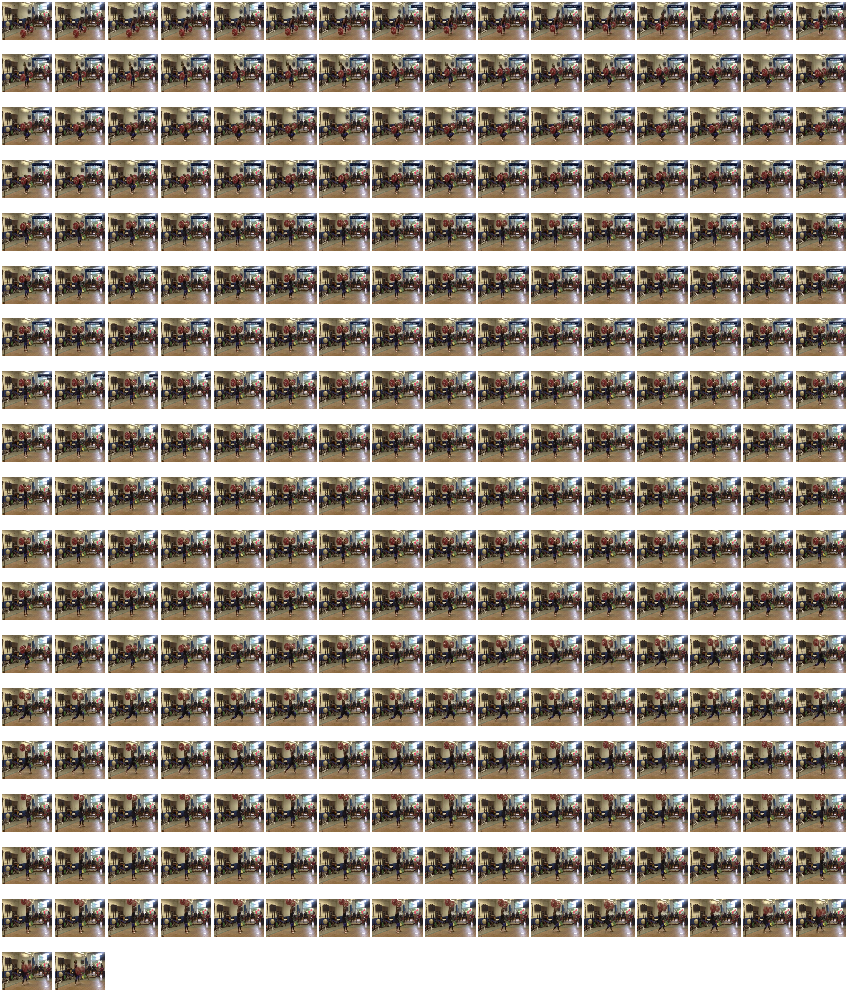

In [7]:
plot_image_grid(image_rows=video_chunks)

First chunk: description: A female athlete stands in a discus throwing ring, preparing to throw. She holds the discus in her right hand, arm extended outward, and begins to rotate her body, initiating the throwing motion.
Second chunk: description: The athlete is preparing to throw the hammer.
First chunk without first frame: description: A female athlete stands in a discus throwing ring, preparing to throw. She holds the discus in her right hand, extended out in front of her. She is wearing a red and white top and green shorts. The background shows a large stadium with spectators.
Second chunk without first frame: description: A female athlete stands in a discus throwing ring, preparing to throw. She holds the discus in her right hand, raised above her head, and begins to rotate her body, winding up for the throw.


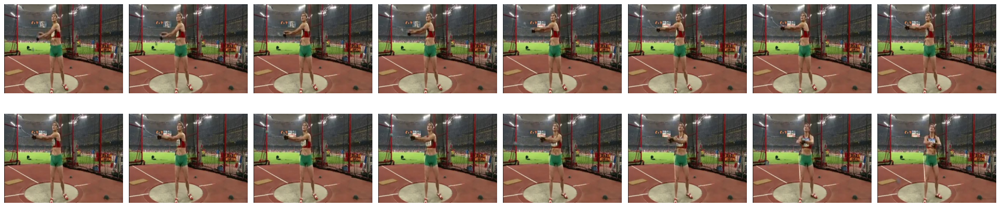

In [10]:
video = tapos_dataset[4]
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]
sampling_fps = 8/0.5

prompt = "Describe the single observable action or event in this 0.5 second video."
#prompt = "Describe the main event of the video."
#prompt = "Describe the single observable event that occurs in this video clip."
#prompt = "Briefly describe the action/event that just started in the current video segment. IMPORTANT: Describe only what is in the current segment."
#prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
current_description = qwen_model.infer(first_chunk, prompt, sample_fps=video_fps)

print(f"First chunk: description: {current_description}")

current_description_second_chunk = qwen_model.infer(video_chunks[1], prompt, sample_fps=video_fps)
print(f"Second chunk: description: {current_description_second_chunk}")

current_description_wo_first_frame = qwen_model.infer(first_chunk[1:], prompt, sample_fps=video_fps)
print(f"First chunk without first frame: description: {current_description_wo_first_frame}")

current_description_second_chunk_wo_first_frame = qwen_model.infer(video_chunks[1][1:], prompt, sample_fps=video_fps)
print(f"Second chunk without first frame: description: {current_description_second_chunk_wo_first_frame}")

plot_image_grid(video_chunks[0:2])

First chunk: description: The video shows a female athlete running on a track and then jumping into a sandpit. She lands in the sandpit and then stands up.
Second chunk: description: A female athlete is running on a track, approaching a long jump pit. She leaps into the air, landing in the sand pit.
First chunk without first frame: description: The video shows a female athlete running on a track, with a crowd of spectators watching her. She is wearing a white and black uniform and appears to be in the middle of a race. As she runs, she passes by a man in a white shirt and black pants who is standing on the track. The athlete continues running, passing by orange cones that are placed on the track. The video ends with the athlete running past the cones and out of the frame.
Second chunk without first frame: description: A female athlete is running on a track, preparing to jump. She is wearing a black and white uniform and has a determined expression on her face. The crowd is cheering her

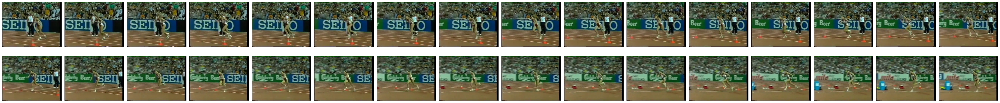

[{'SAME': 0.9921875, 'NEW': 0.00592041015625},
 {'SAME': 0.9921875, 'NEW': 0.00970458984375, 'LABEL': 0},
 {'SAME': 0.98828125, 'NEW': 0.012451171875, 'LABEL': 0},
 {'SAME': 0.98046875, 'NEW': 0.0203857421875, 'LABEL': 0},
 {'SAME': 0.99609375, 'NEW': 0.005218505859375, 'LABEL': 0},
 {'SAME': 0.004058837890625, 'NEW': 0.99609375, 'LABEL': 0},
 {'SAME': 0.000431060791015625, 'NEW': 1.0, 'LABEL': 1}]

In [32]:
video = tapos_dataset[8]
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]

prompt = "Describe the main event of the video chunk."
#prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
current_description = qwen_model.infer(first_chunk, prompt, sample_fps=video_fps)

print(f"First chunk: description: {current_description}")

current_description_second_chunk = qwen_model.infer(video_chunks[1], prompt, sample_fps=video_fps)
print(f"Second chunk: description: {current_description_second_chunk}")

current_description_wo_first_frame = qwen_model.infer(first_chunk[1:], prompt, sample_fps=video_fps)
print(f"First chunk without first frame: description: {current_description_wo_first_frame}")

current_description_second_chunk_wo_first_frame = qwen_model.infer(video_chunks[1][1:], prompt, sample_fps=video_fps)
print(f"Second chunk without first frame: description: {current_description_second_chunk_wo_first_frame}")

plot_image_grid(video_chunks[0:2])


alignment_prompt = "Given the previous event description: {previous_description}, is this the same event or a new one? Respond ONLY with 'SAME' if it's the same or 'NEW' if it's a new event."
alignment_prompt = alignment_prompt.format(previous_description=current_description)

cand_probs_list = []

for idx, chunk in enumerate(video_chunks[1:]):
    frame_chunk = chunk
    inputs = qwen_model._prepare_inputs(frame_chunk, alignment_prompt, sample_fps=video_fps)
    cand_prob = qwen_model.get_next_token_probs(frame_chunk, alignment_prompt, sample_fps=video_fps, candidate_strings=["SAME", "NEW"])
    cand_probs_list.append(cand_prob)

cand_probs_list, video["chunk_labels"]

# Assuming 'cand_probs_list' and 'video' are defined as in your snippet

# 1. Flatten the labels list (since it's inside a nested list [[...]])
chunk_labels = video["chunk_labels"][0]

# 2. Iterate starting from the second entry (index 1) of cand_probs_list
#    and the first entry (index 0) of chunk_labels simultaneously.
#    We use zip to pair them up safely.
for prob_entry, label in zip(cand_probs_list[1:], chunk_labels):
    prob_entry['LABEL'] = label

cand_probs_list